1. Inverted Images
2. Rescaling
3. Binarization
4. Noise Removal
5. Dilation and Erosion
6. Rotation / Deskewing
7. Removing Borders
8. Missing Borders
9. Transparency / Alpha Channel

In [6]:
pip install opencv-python

Note: you may need to restart the kernel to use updated packages.


In [7]:
pip install pillow

Note: you may need to restart the kernel to use updated packages.


In [8]:
pip install pytesseract

  Using cached pytesseract-0.3.10-py3-none-any.whl (14 kB)
Note: you may need to restart the kernel to use updated packages.


In [9]:
import cv2
from PIL import Image
import pytesseract
from matplotlib import pyplot as plt
import numpy as np

In [10]:
image_file = "data/page_01.jpg"
img = cv2.imread(image_file)

In [12]:
#from google.colab.patches import cv2_imshow

In [13]:
#cv2_imshow(img)
#cv2.waitKey(0)

In [14]:
#https://stackoverflow.com/questions/28816046/
#displaying-different-images-with-actual-size-in-matplotlib-subplot
def display(im_path):
    dpi = 80
    im_data = plt.imread(im_path)

    height, width  = im_data.shape[:2]
    
    # What size does the figure need to be in inches to fit the image?
    figsize = width / float(dpi), height / float(dpi)

    # Create a figure of the right size with one axes that takes up the full figure
    fig = plt.figure(figsize=figsize)
    ax = fig.add_axes([0, 0, 1, 1])

    # Hide spines, ticks, etc.
    ax.axis('off')

    # Display the image.
    ax.imshow(im_data, cmap='gray')

    plt.show()

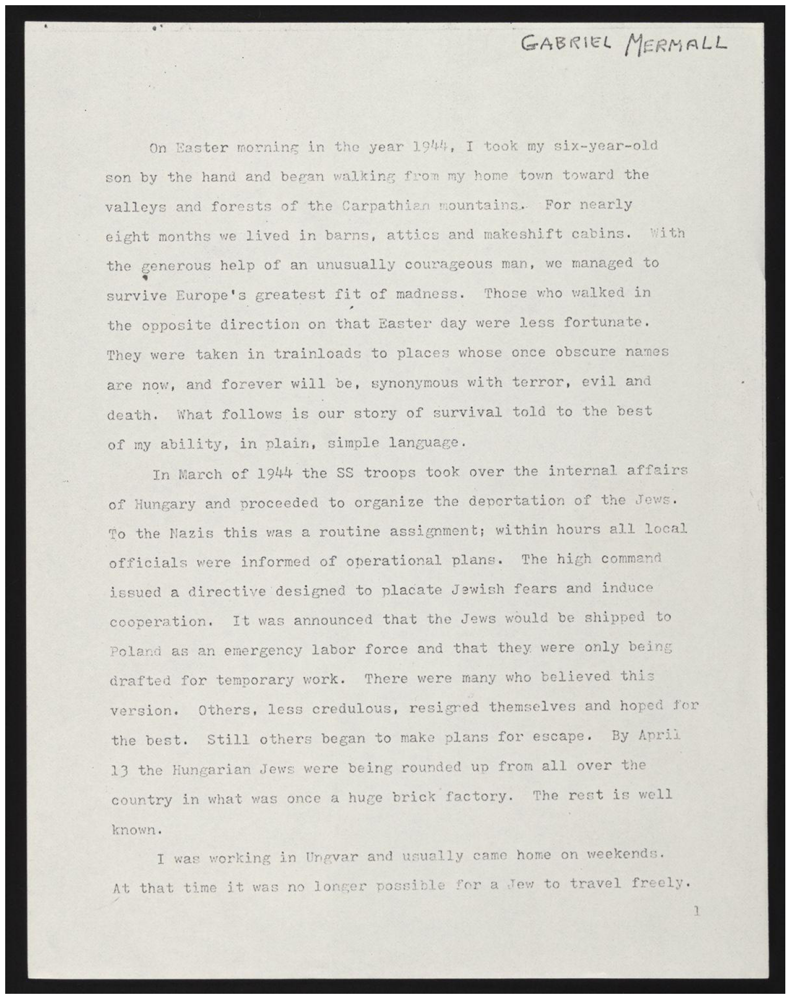

In [15]:
display(image_file)

# 01: Inverted Images

In [17]:
 inverted_image = cv2.bitwise_not(img)
 cv2.imwrite("data/inverted.jpg", inverted_image)

True

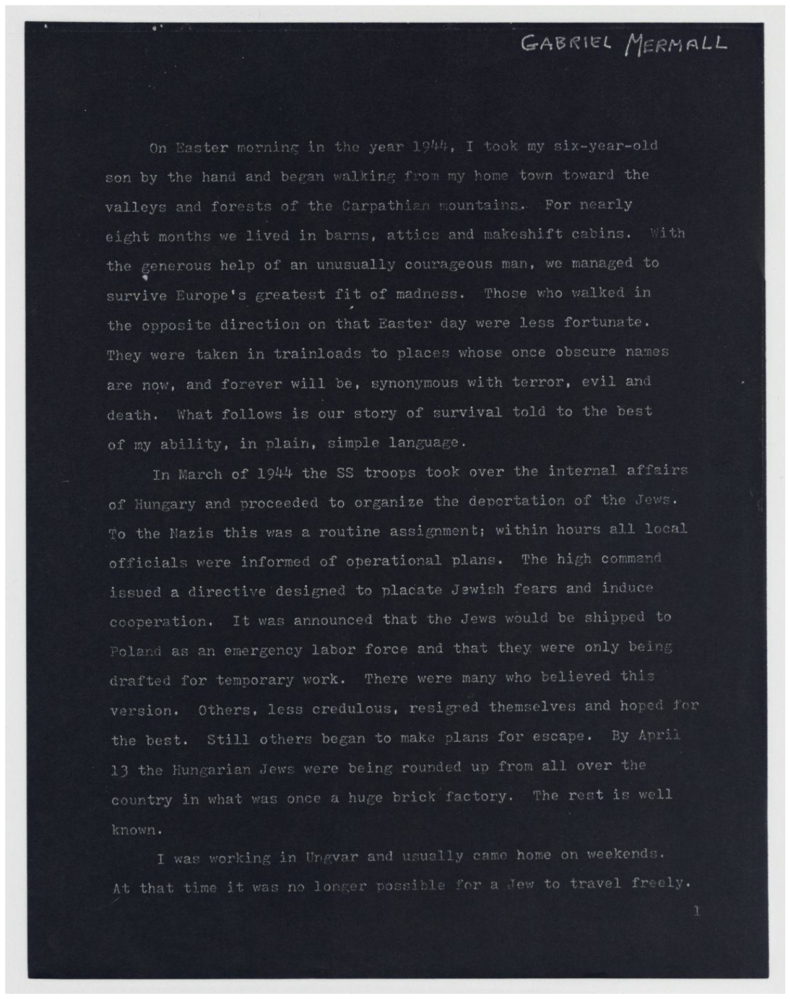

In [19]:
display("data/inverted.jpg")

# 02: Rescaling

# 03: Binarization

In [20]:
def grayscale(image):
  return cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

In [21]:
gray_image = grayscale(img)
cv2.imwrite("data/gray.jpg", gray_image)

True

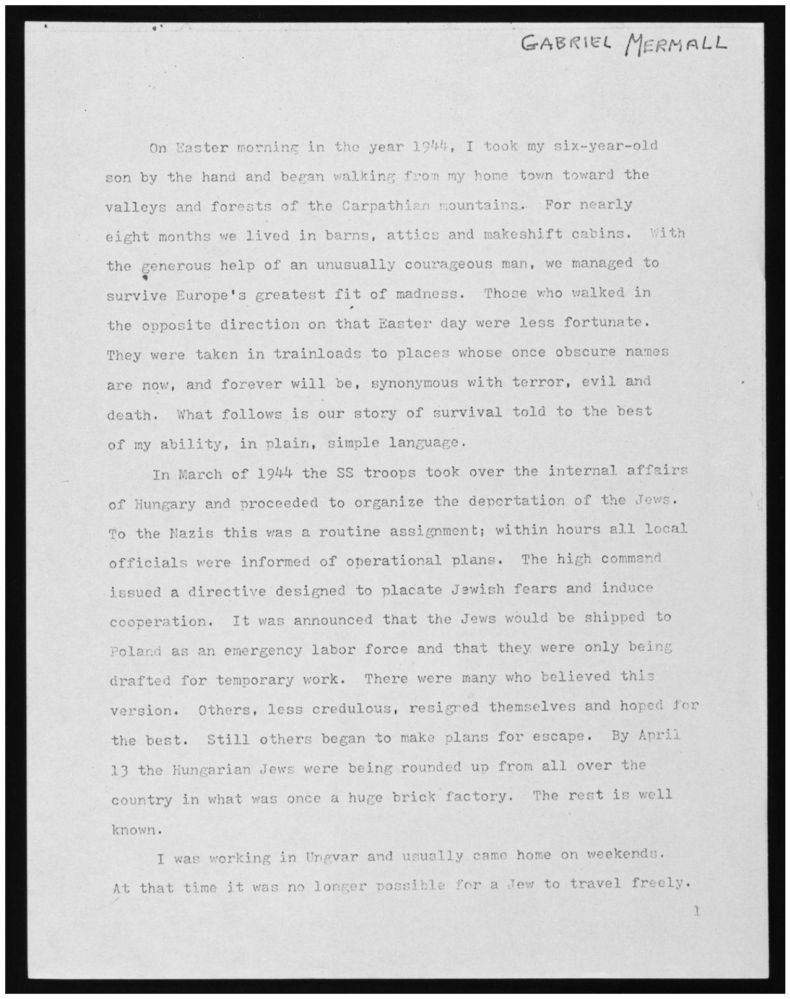

In [22]:
display("data/gray.jpg")

In [23]:
thresh, im_bw = cv2.threshold(gray_image, 127, 255, cv2.THRESH_BINARY)
cv2.imwrite("data/bw_image.jpg", im_bw)

True

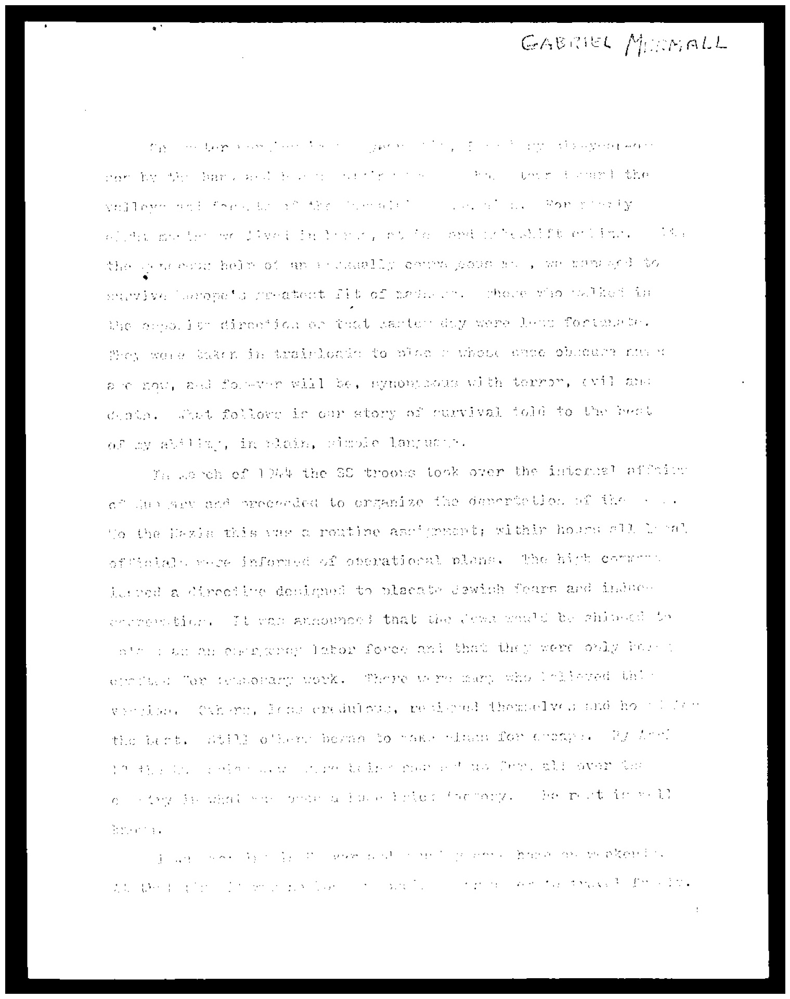

In [24]:
display("data/bw_image.jpg")

In [25]:
thresh, im_bw = cv2.threshold(gray_image, 200, 230, cv2.THRESH_BINARY)
cv2.imwrite("data/bw_image.jpg", im_bw)

True

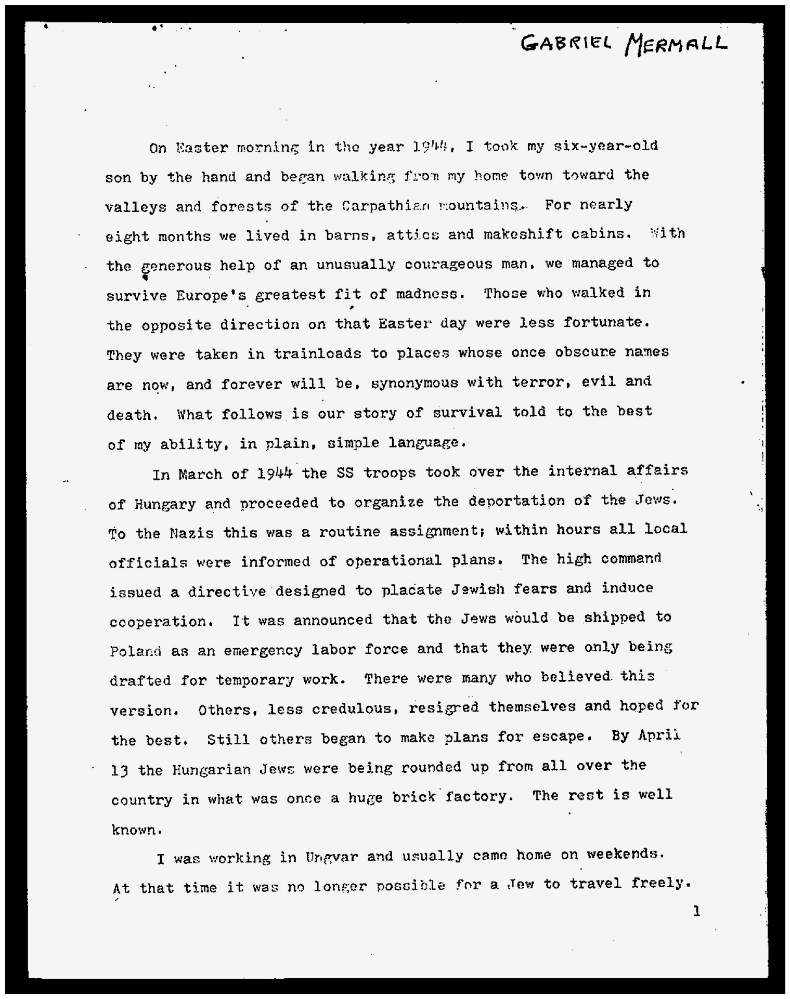

In [26]:
display("data/bw_image.jpg")

# 04: Noise Removal

In [27]:
def noise_removal(image):
  kernel = np.ones((1,1), np.uint8)
  image = cv2.dilate(image, kernel, iterations = 1)
  kernel = np.ones((1,1), np.uint8)
  image = cv2.erode(image, kernel, iterations = 1)
  image = cv2.morphologyEx(image, cv2.MORPH_CLOSE, kernel)
  image = cv2.medianBlur(image, 3)
  return (image)

In [28]:
no_noise = noise_removal(im_bw)
cv2.imwrite("data/no_noise.jpg", no_noise)

True

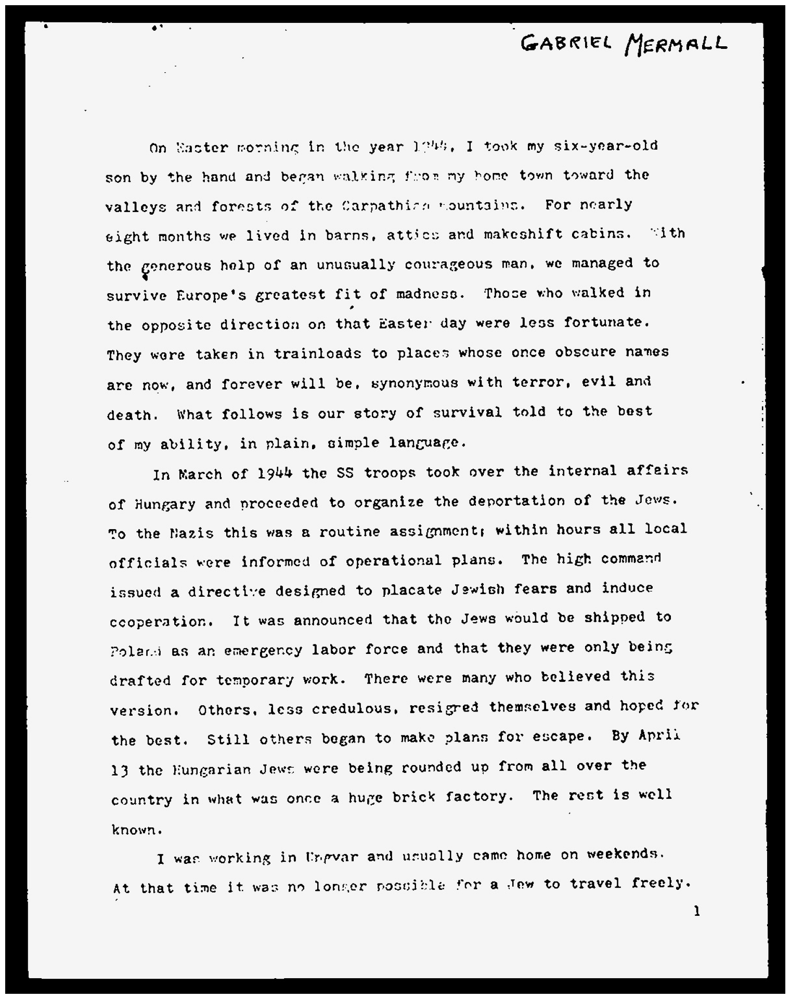

In [29]:
display("data/no_noise.jpg")

# 05: Dilation and Erosion

In [30]:
def thin_font(image):
  image = cv2.bitwise_not(image)
  kernel = np.ones((2,2), np.uint8)
  image = cv2.erode(image, kernel, iterations = 1)
  image = cv2.bitwise_not(image)
  return(image)

In [31]:
eroded_image = thin_font(no_noise)
cv2.imwrite("data/eroded_image.jpg", eroded_image)

True

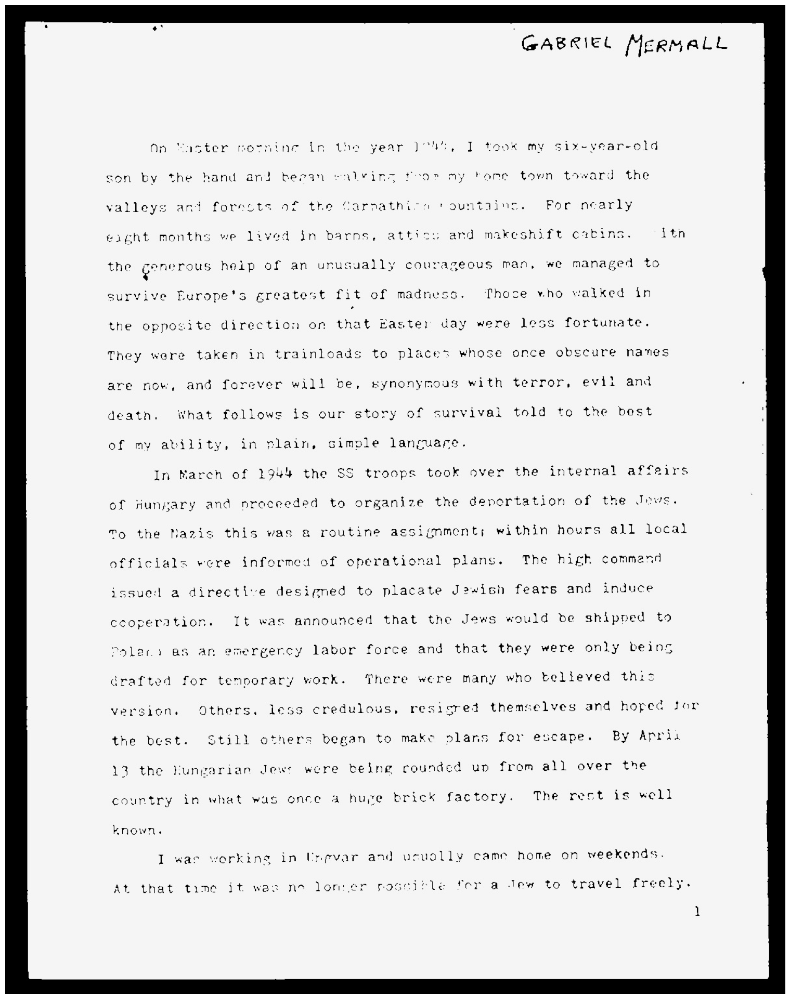

In [32]:
display("data/eroded_image.jpg")

In [33]:
def thick_font(image):
  image = cv2.bitwise_not(image)
  kernel = np.ones((2,2), np.uint8)
  image = cv2.dilate(image, kernel, iterations = 1)
  image = cv2.bitwise_not(image)
  return(image)

In [34]:
dilated_image = thick_font(no_noise)
cv2.imwrite("data/dilated_image.jpg", dilated_image)

True

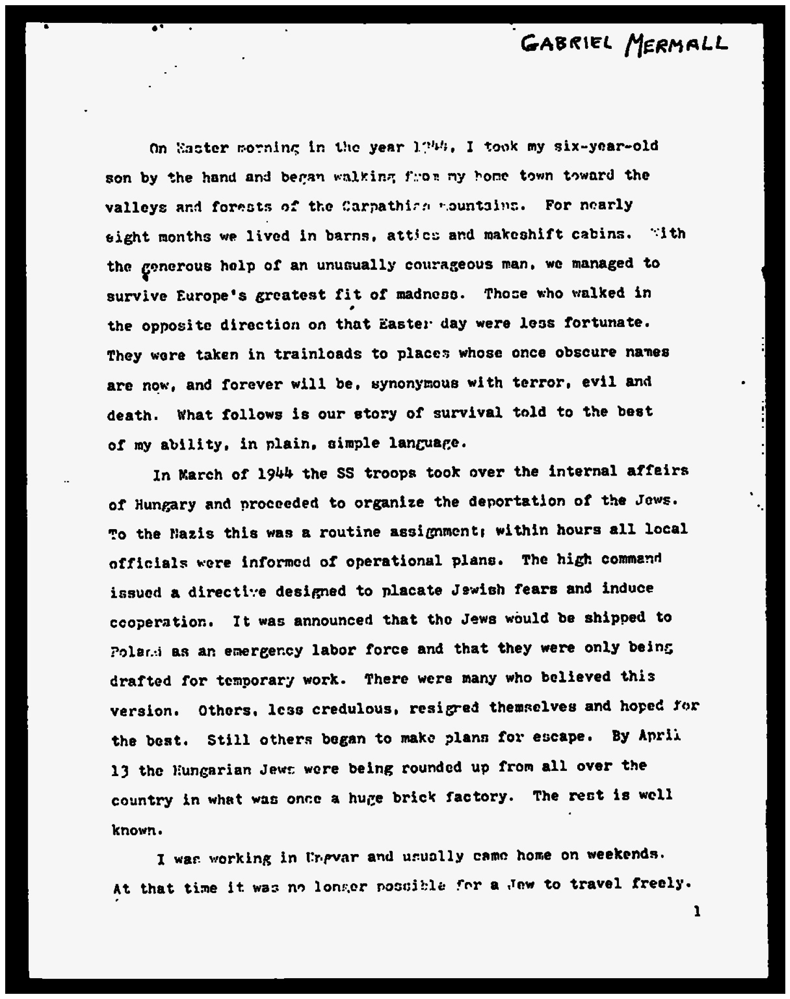

In [35]:
display("data/dilated_image.jpg")

# 06: Rotation / Deskewing

In [36]:
new = cv2.imread("data/page_01_rotated.JPG")

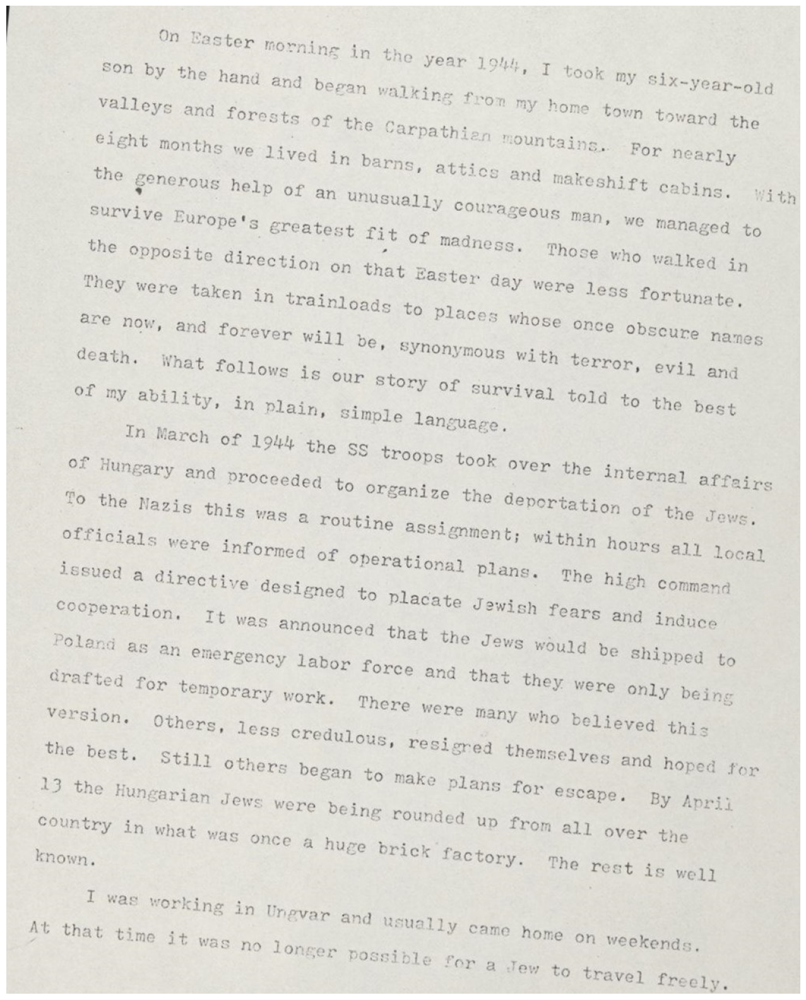

In [37]:
display("data/page_01_rotated.JPG")

In [38]:
#https://becominghuman.ai/how-to-automatically-deskew-straighten-a-text-image-using-opencv-a0c30aed83df
import numpy as np

def getSkewAngle(cvImage) -> float:
    # Prep image, copy, convert to gray scale, blur, and threshold
    newImage = cvImage.copy()
    gray = cv2.cvtColor(newImage, cv2.COLOR_BGR2GRAY)
    blur = cv2.GaussianBlur(gray, (9, 9), 0)
    thresh = cv2.threshold(blur, 0, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU)[1]

    # Apply dilate to merge text into meaningful lines/paragraphs.
    # Use larger kernel on X axis to merge characters into single line, cancelling out any spaces.
    # But use smaller kernel on Y axis to separate between different blocks of text
    kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (30, 5))
    dilate = cv2.dilate(thresh, kernel, iterations=2)

    # Find all contours
    contours, hierarchy = cv2.findContours(dilate, cv2.RETR_LIST, cv2.CHAIN_APPROX_SIMPLE)
    contours = sorted(contours, key = cv2.contourArea, reverse = True)
    for c in contours:
        rect = cv2.boundingRect(c)
        x,y,w,h = rect
        cv2.rectangle(newImage,(x,y),(x+w,y+h),(0,255,0),2)

    # Find largest contour and surround in min area box
    largestContour = contours[0]
    print (len(contours))
    minAreaRect = cv2.minAreaRect(largestContour)
    cv2.imwrite("temp/boxes.jpg", newImage)
    # Determine the angle. Convert it to the value that was originally used to obtain skewed image
    angle = minAreaRect[-1]
    if angle < -45:
        angle = 90 + angle
    return -1.0 * angle
# Rotate the image around its center
def rotateImage(cvImage, angle: float):
    newImage = cvImage.copy()
    (h, w) = newImage.shape[:2]
    center = (w // 2, h // 2)
    M = cv2.getRotationMatrix2D(center, angle, 1.0)
    newImage = cv2.warpAffine(newImage, M, (w, h), flags=cv2.INTER_CUBIC, borderMode=cv2.BORDER_REPLICATE)
    return newImage

In [39]:
# Deskew image
def deskew(cvImage):
    angle = getSkewAngle(cvImage)
    return rotateImage(cvImage, -1.0 * angle)

In [40]:
fixed = deskew(new)
cv2.imwrite("data/rotated_fixed.jpg", fixed)

28


True

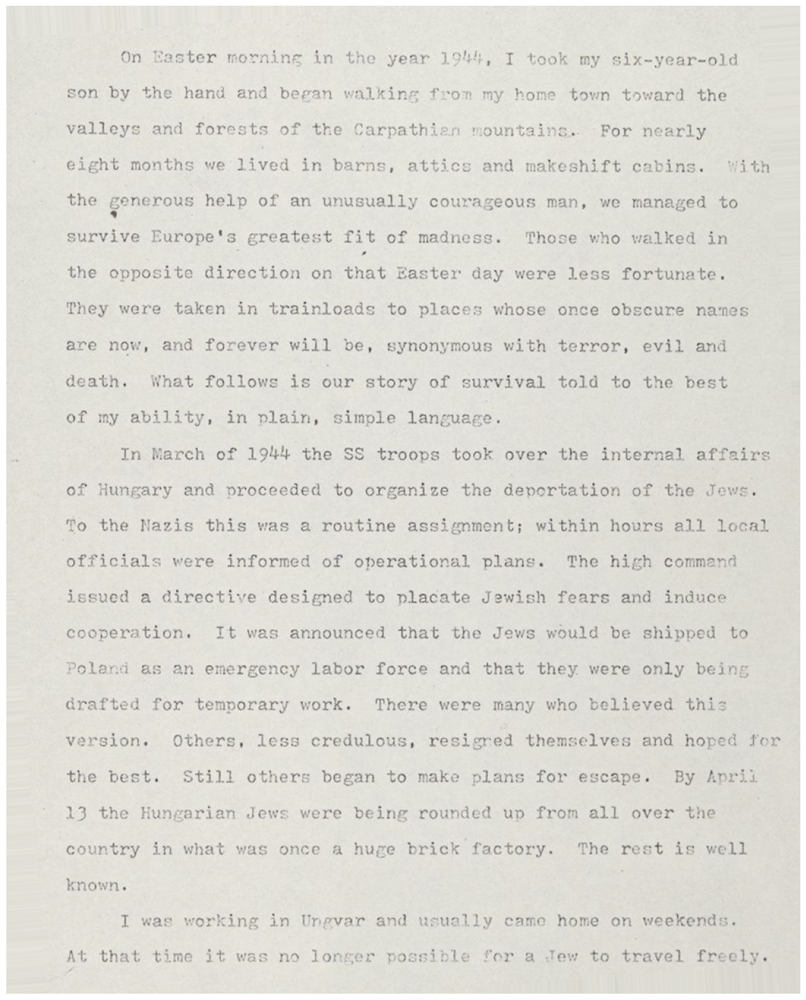

In [41]:
display("data/rotated_fixed.jpg")

# 07: Removing Borders

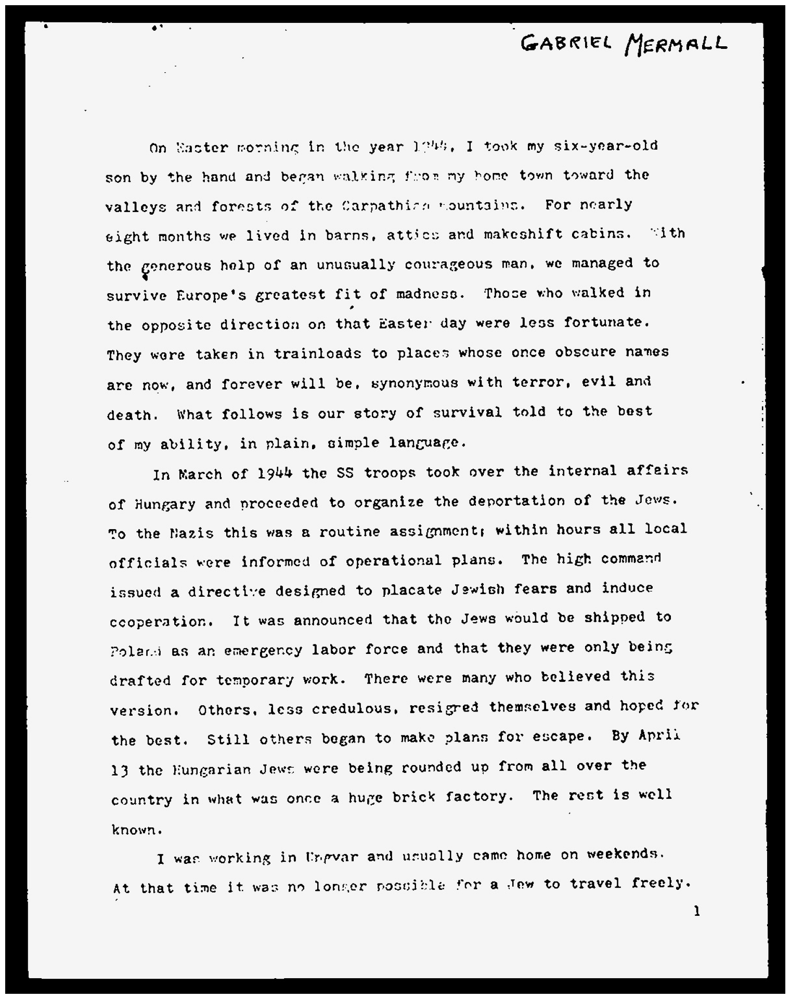

In [42]:
display("data/no_noise.jpg")

In [43]:
def remove_borders(image):
    contours, heiarchy = cv2.findContours(image, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    cntsSorted = sorted(contours, key=lambda x:cv2.contourArea(x))
    cnt = cntsSorted[-1]
    x, y, w, h = cv2.boundingRect(cnt)
    crop = image[y:y+h, x:x+w]
    return (crop)

In [44]:
no_borders = remove_borders(no_noise)
cv2.imwrite("data/no_borders.jpg", no_borders)

True

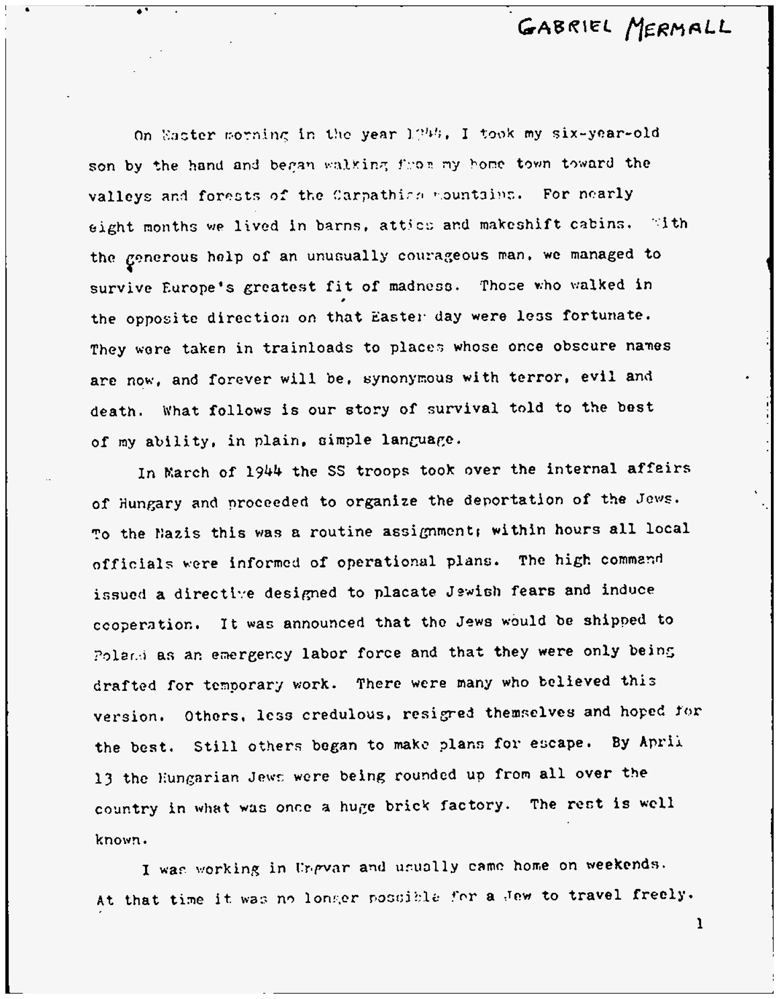

In [45]:
display("data/no_borders.jpg")

# 08: Missing Borders

In [46]:
color = [255, 255, 255]
top, bottom, left, right = [150] * 4

In [47]:
image_with_border = cv2.copyMakeBorder(no_borders, top, bottom, left, right, cv2.BORDER_CONSTANT, value=color)
cv2.imwrite("data/image_with_border.jpg", image_with_border)

True

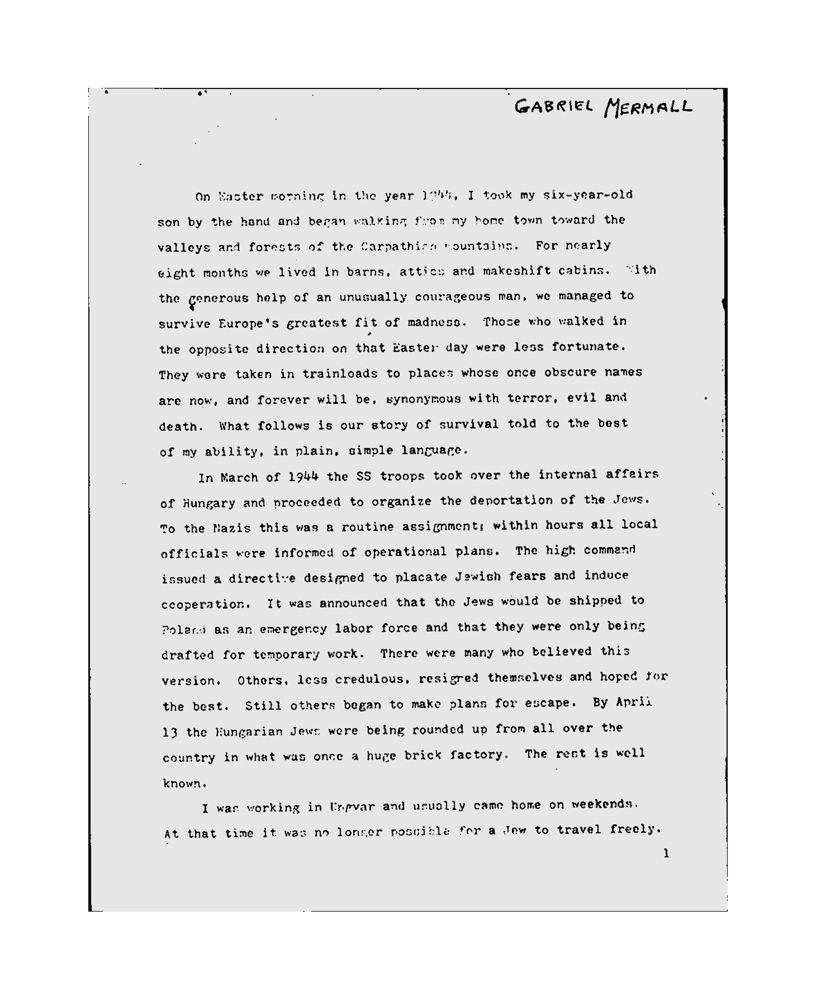

In [48]:
display("data/image_with_border.jpg")

In [49]:
img_file = "data/page_01.jpg"

In [50]:
no_noise = "data/no_noise.jpg"

In [51]:
img = Image.open(img_file)

In [52]:
ocr_result = pytesseract.image_to_string(img)

In [54]:
print(ocr_result)

In [55]:
img = Image.open(no_noise)

In [56]:
ocr_result = pytesseract.image_to_string(img)

In [57]:
print(ocr_result)

“GABRIEL NMermace

On Easter motning in the year 175, I took my six-year-old
son by the hand and beran walking fron my home town toward the
valleys and forests of the Carpathirs rountains. For nearly
eight months we lived in barns, attics and makeshift cabins. “ith
the poncuos help of an unusually courageous man, we managed to
survive Europe's greatest fit of madness. Those who walked in
the opposite direction on that Easter day were less fortunate.
They wore taken in trainloads to places whose once obscure nanes
are now, and forever will be, synonymous with terror, evil and
death. What follows is our story of survival told to the best
of my ability, in plain, simple languare.

In March of 1944 the SS troops took over the internal affeirs
of Hungary and proceeded to organize the deportation of the Jews.
™> the Nazis this was a routine assignment; within hours all local
officials were informed of operational plans. The high command
issued a directive designed to placate Jewish fears and

In [60]:
image_file = "data/index_02.JPG"

In [61]:
img = Image.open(image_file)

In [62]:
ocr_result = pytesseract.image_to_string(img)

In [63]:
print(ocr_result)

INDEX NOMINUM.

SCRIPSIT KAROLUS HAMPE.

Maior numerus indicat paginam, minor lineam.

A. v. E.

Aaron 38, 20. 123, 18. 168, 6. 203, 38. |

Abacuc propheta 36,5. 319,29. 373, 23.
Abagarus rex Edessenorum 382, 13.
Abdenago 585, 3.

Abel 26, 11.

Abigail 606, 6.

Abraham 26,18. 124,18. 133, 23. 2:
264. 302, 13. 303, 13. 320, 40. 328, 1.
496, 22.

Absalon 102, 5.

Acgfredi v. Ecgfridus.

Achab rex 504, 1.

Achaz rex 504,1.

Achiel 606, 19.

Achilon 496, 26.

Adal-, Adel-, Adhel-, Aedel-, Aedel-,
‘Aedil-, Aed
Athel-, Athil-, Aethel-, Aethil-,
Ethel-.

Aedelbaldusabb.S. Petri Wiremuthen-
sis et S. Pauli Girwensis 110, 28.

Aedilberctus, Aedilberthus ep. Ha-
gulstadensis, antea ep. Candidae
casae sive Witernensis 27,43. 72,16.

Adalbertus, Aedilberctus sive Magus,
discipulus et capellanus Arnonis
archiep. Salisburg., postea_abb.
Ferrariensis 254, 1. 320, 41. 322, 19.
416. 418, 14. 422, 10.

Adalpertabb. [Tegernseensis ?]497,23.

Adalbertus presb. monasterii 8. Mar-
tini Turonensis 399, 3.

A

In [64]:
image = cv2.imread("data/index_02.JPG")

In [65]:
gray = cv2.cvtColor(image,cv2.COLOR_BGR2GRAY)

In [66]:
cv2.imwrite("temp/index_gray.png", gray)

True

In [68]:
blur = cv2.GaussianBlur(gray, (7,7), 0)

In [69]:
cv2.imwrite("temp/index_blur.png", blur)

True

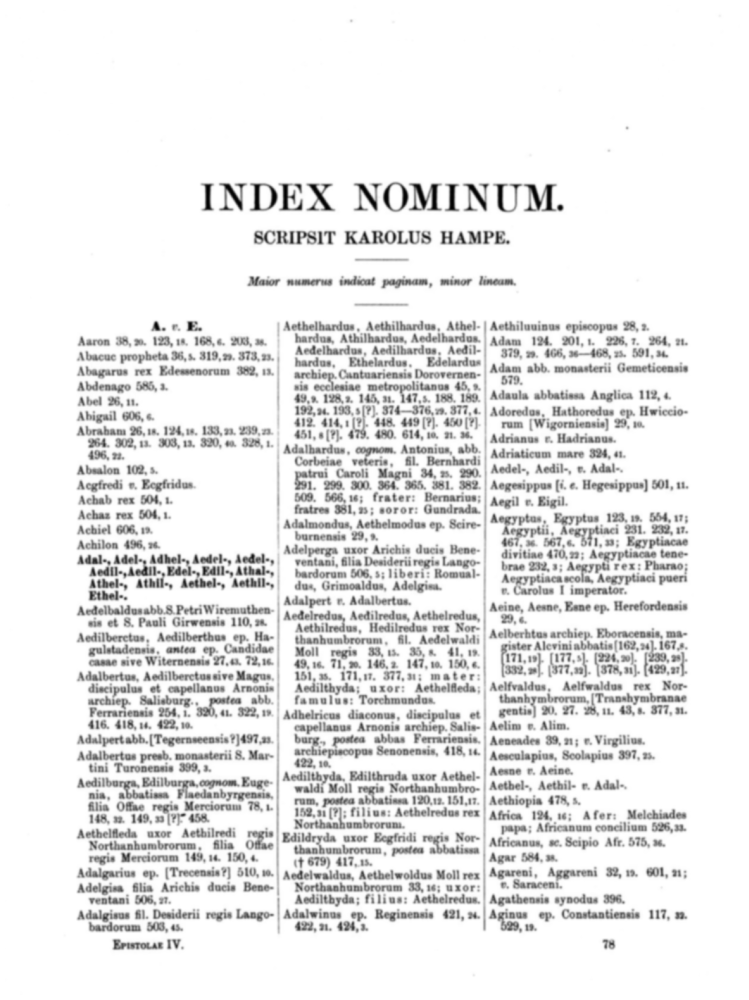

In [70]:
display("temp/index_blur.png")

In [74]:
thresh = cv2.threshold(blur, 0, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU)[1]

In [75]:
cv2.imwrite("temp/index_thresh.png", thresh)

True

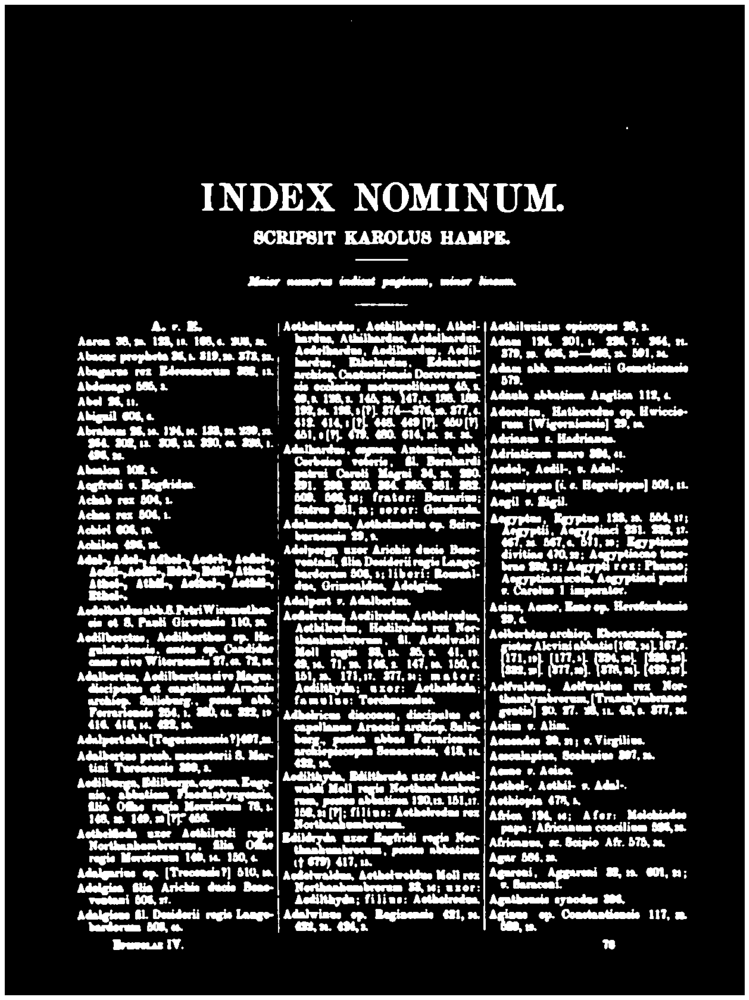

In [76]:
display("temp/index_thresh.png")

In [79]:
kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (3,13))

In [80]:
cv2.imwrite("temp/index_kernel.png", kernel)

True

In [81]:
display("temp/index_kernel.png")

In [82]:
dilate = cv2.dilate(thresh, kernel , iterations = 1)

In [83]:
cv2.imwrite("temp/index_dilate.png", dilate)

True

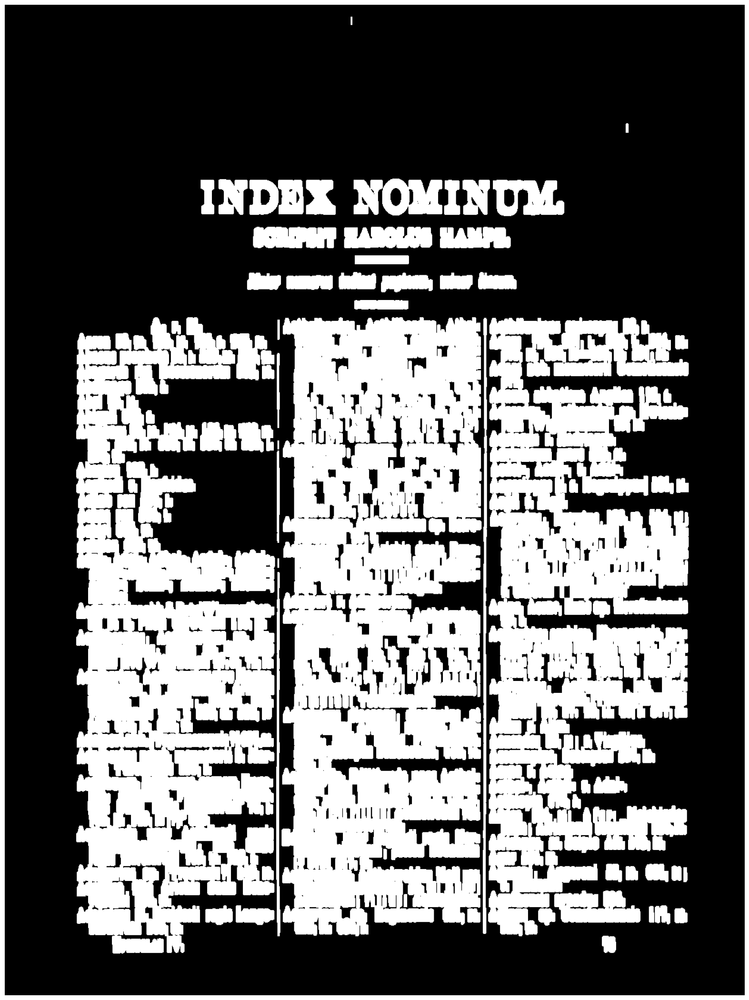

In [84]:
display("temp/index_dilate.png")

In [85]:
# cnts = contours
cnts = cv2.findContours(dilate, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

In [86]:
cnts = cnts[0] if len(cnts) == 2 else cnts[1]

In [87]:
cnts = sorted(cnts, key=lambda x: cv2.boundingRect(x)[0])

In [88]:
for c in cnts:
    x, y, w, h = cv2.boundingRect(c)
    cv2.rectangle(image, (x, y), (x+w, y+h), (36,255,12), 2)
cv2.imwrite("temp/index_bbox.png", image)

True

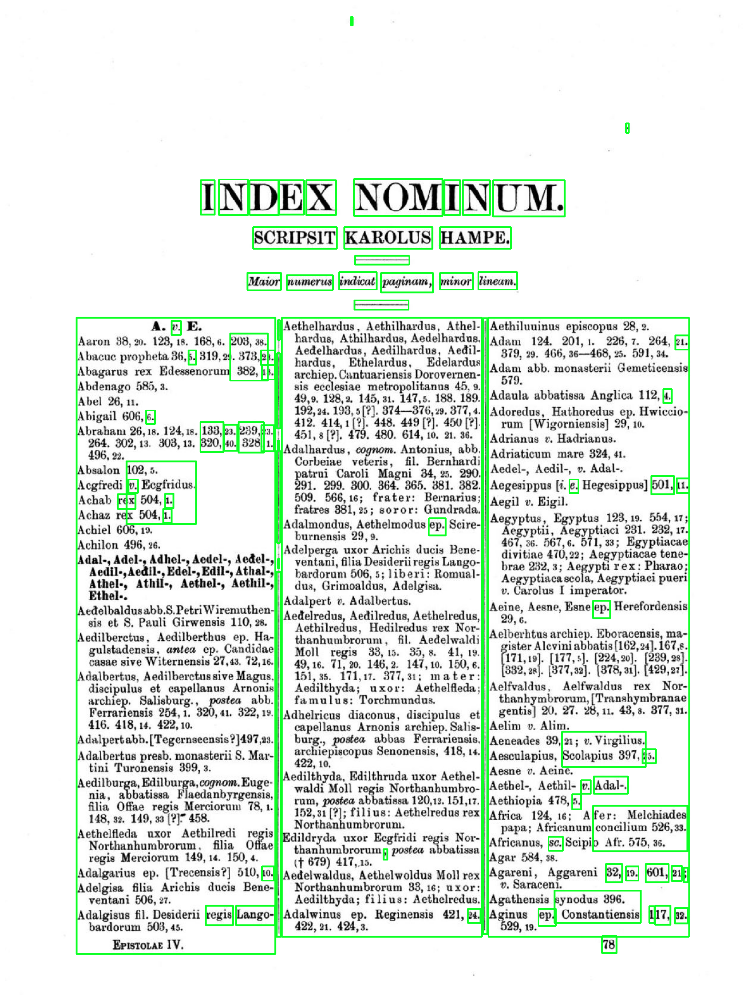

In [89]:
display("temp/index_bbox.png")

In [93]:
 for c in cnts:
    x, y, w, h = cv2.boundingRect(c)
    if h > 200 and w > 20:
        cv2.rectangle(image, (x, y), (x+w, y+h), (36,255,12), 2)
cv2.imwrite("temp/index_bbox.png", image)

True

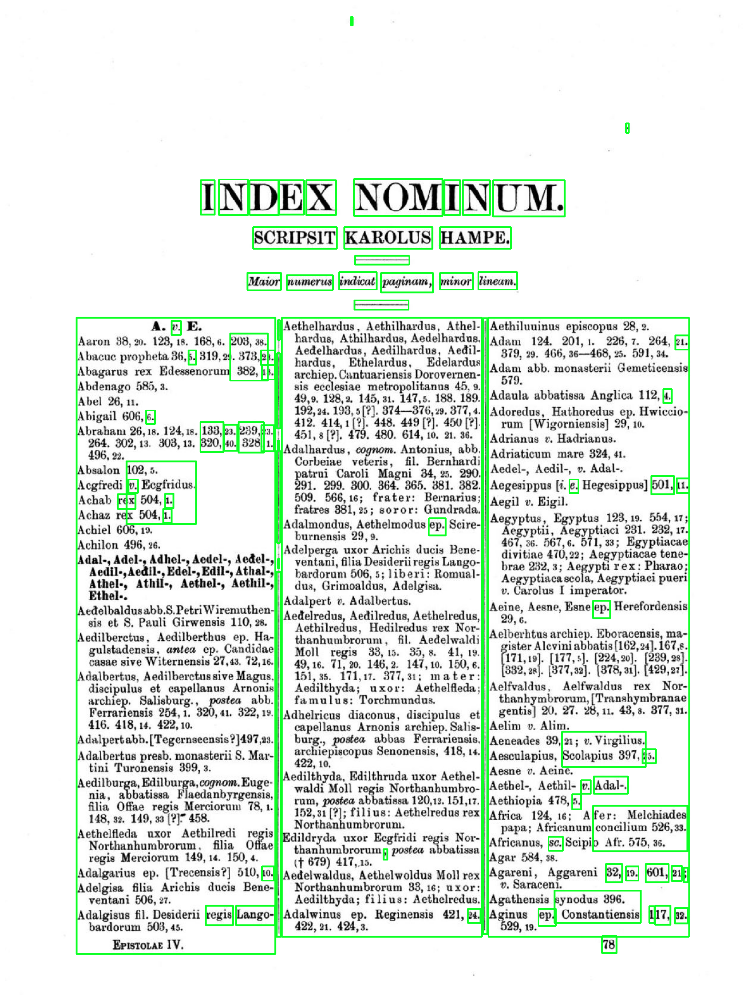

In [94]:
display("temp/index_bbox.png")